In [1]:
import os
import math
import argparse
import numpy as np
from PIL import Image, ImageOps
from matplotlib import pyplot as plt

import torch
from torch.autograd import Variable

In [10]:
IMG_EXTENSIONS = [
    '.jpg', '.JPG', '.jpeg', '.JPEG',
    '.png', '.PNG', '.ppm', '.PPM', '.bmp', '.BMP',
]
def is_image_file(filename):
    return any(filename.endswith(extension) for extension in IMG_EXTENSIONS)

def make_dataset(dir, dataset_name):
    print(dir)
    images = []
    assert os.path.isdir(dir), '%s is not a valid directory' % dir

    for root, _, fnames in sorted(os.walk(dir)):
        for fname in fnames:
            if is_image_file(fname):
                if dataset_name=='SOTS-indoor' and '_' in fname and '_10' not in fname:
                    continue
                if '.ipynb_checkpoints' in dir:
                    continue
                path = os.path.join(root, fname)
                images.append(path)

    return images

In [3]:
## Dataset loader

def resize_img(img):
    im_w, im_h = img.size
    # resize the image into multiple of 4
    if im_w % 4 != 0 or im_h % 4 != 0:
        img = img.resize((int(im_w // 4 * 4), int(im_h // 4 * 4))) 
        im_w, im_h = img.size
    # resize the big image to save the gpu memory
    while im_w > 2048:
        img = img.resize((int(im_w // 2), int(im_h // 2)))  
        im_w, im_h = img.size
    return img

def dataset_loader(name):
    """
    Load the dataset into the memory
    name: 'I-HAZY', 'O-HAZY', 'SOTS-indoor', 'SOTS-outdoor'
    """
    hazy_path = {
        'I-HAZY' : '# I-HAZY NTIRE 2018/hazy',
        'O-HAZY' : '# O-HAZY NTIRE 2018/hazy',
        'SOTS-indoor' : 'SOTS/indoor/hazy',
        'SOTS-outdoor' : 'SOTS/outdoor/hazy',
    }
    clear_path = {
        'I-HAZY' : '# I-HAZY NTIRE 2018/GT',
        'O-HAZY' : '# O-HAZY NTIRE 2018/GT',
        'SOTS-indoor' : 'SOTS/indoor/clear',
        'SOTS-outdoor' : 'SOTS/outdoor/clear',        
    }
    train_img_paths = make_dataset('dataset/'+hazy_path[name], name)
    truth_img_paths = make_dataset('dataset/'+clear_path[name], name)
    for train_path, truth_path in zip(train_img_paths, truth_img_paths):
        train_img = resize_img(Image.open(train_path).convert('RGB'))
        truth_img = resize_img(Image.open(truth_path).convert('RGB'))
        yield train_img, truth_img

In [4]:
def psnr(target, ref):
    # convert image into float64
    target_data = np.array(target, dtype=np.float64)
    ref_data = np.array(ref,dtype=np.float64)
    # calculate difference
    diff = ref_data - target_data
    # flatten the rgb channels
    diff = diff.flatten('C')
    # calculate RSE
    rmse = math.sqrt(np.mean(diff ** 2.))
    # precision
    eps = np.finfo(np.float64).eps
    if(rmse == 0):
        rmse = eps 
    return 20*math.log10(255.0/rmse)

import pytorch_ssim
def ssim(img1,img2):
    img1 = torch.from_numpy(np.rollaxis(np.array(img1), 2)).float().unsqueeze(0)/255.0
    img2 = torch.from_numpy(np.rollaxis(np.array(img2), 2)).float().unsqueeze(0)/255.0   
    img1 = Variable(img1, requires_grad=False)    # torch.Size([256, 256, 3])
    img2 = Variable(img2, requires_grad=False)
    ssim_value = pytorch_ssim.ssim(img1, img2).item()
    return ssim_value

In [5]:
dataset_name = 'SOTS-indoor'

dataset/SOTS/indoor/hazy
dataset/SOTS/indoor/clear


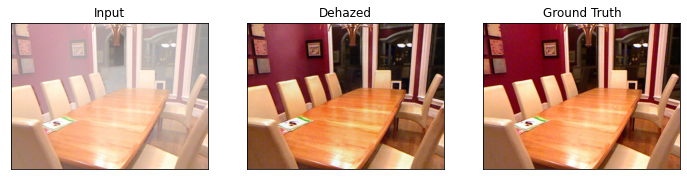

psnr: 23.43391667235611   ssim: 0.909344494342804


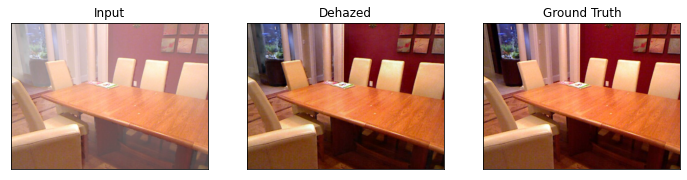

psnr: 24.755075331632664   ssim: 0.9294339418411255


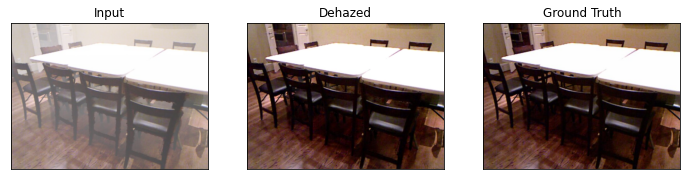

psnr: 25.725088637690714   ssim: 0.9428516626358032


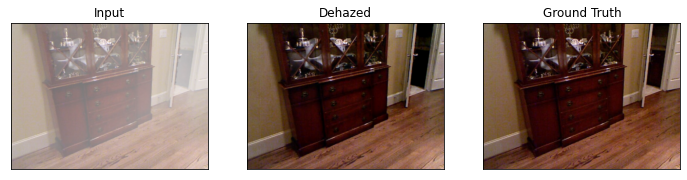

psnr: 29.36533109615736   ssim: 0.9315056800842285


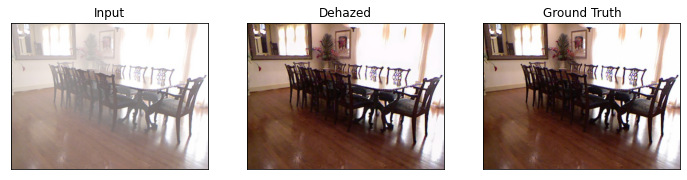

psnr: 31.949790743688165   ssim: 0.9775157570838928


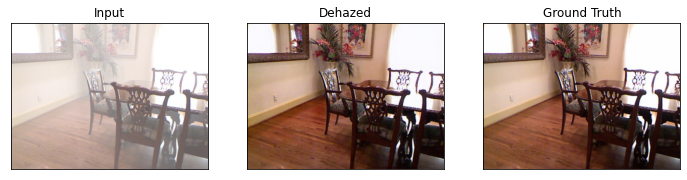

psnr: 26.560850882486868   ssim: 0.9657760858535767


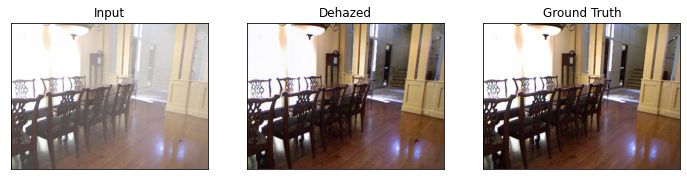

psnr: 29.430216927858496   ssim: 0.9663469791412354


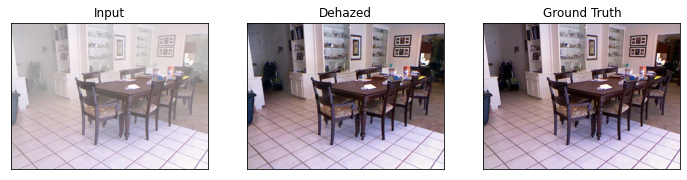

psnr: 30.174933180132854   ssim: 0.9671677947044373


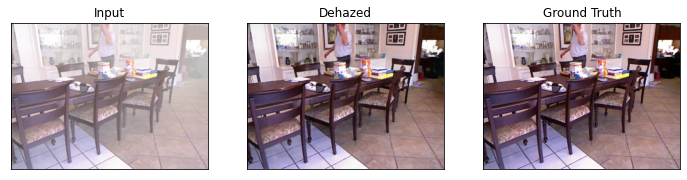

psnr: 28.791171275928022   ssim: 0.9692854285240173


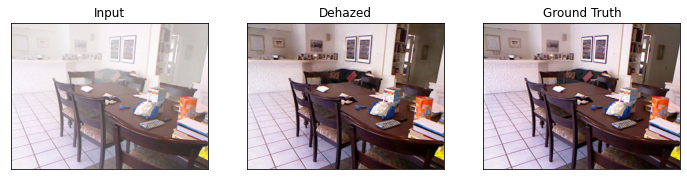

psnr: 26.9369097959164   ssim: 0.9563231468200684


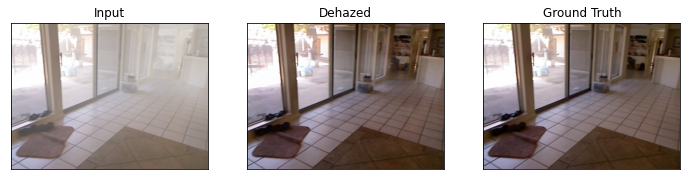

psnr: 29.168602549076983   ssim: 0.971147358417511


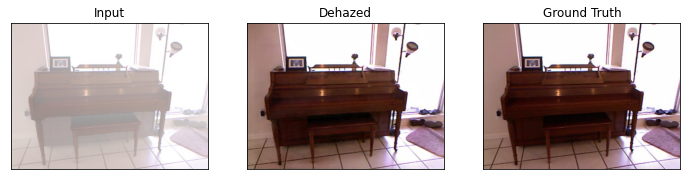

psnr: 30.691145081338593   ssim: 0.9605168700218201


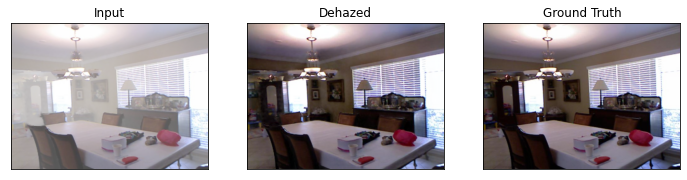

psnr: 26.674559293596687   ssim: 0.9481772184371948


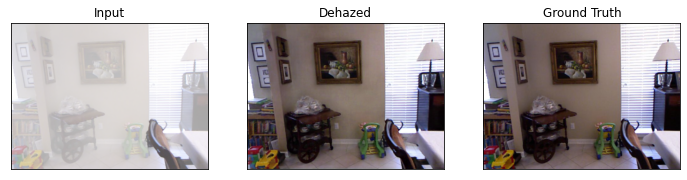

psnr: 28.00519220104498   ssim: 0.9541694521903992


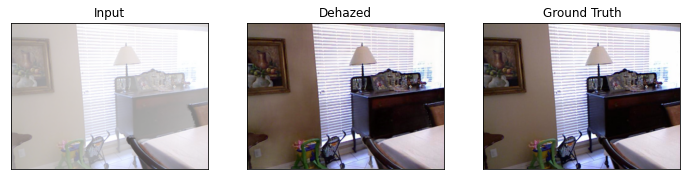

psnr: 26.56090176652869   ssim: 0.9556182622909546


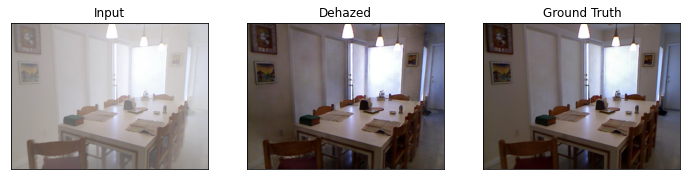

psnr: 27.78929235971968   ssim: 0.949721097946167


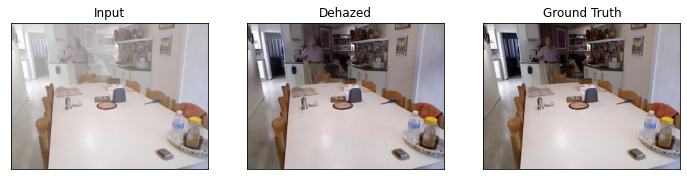

psnr: 26.89480798398588   ssim: 0.9684500694274902


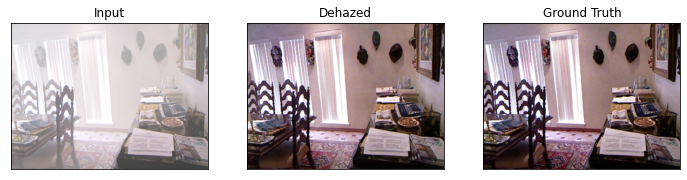

psnr: 27.054517753080308   ssim: 0.9625923037528992


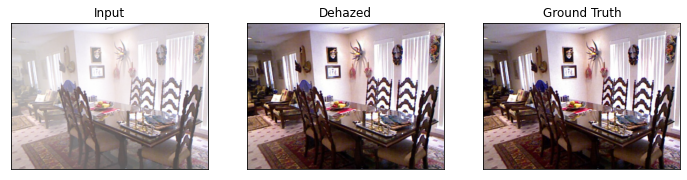

psnr: 29.09024172199485   ssim: 0.9645671248435974


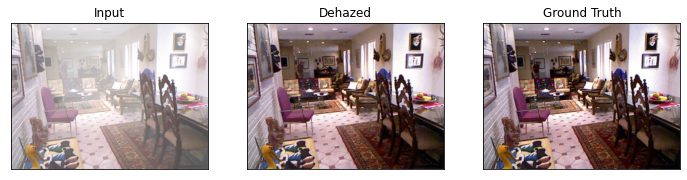

psnr: 29.43926213389185   ssim: 0.96930992603302


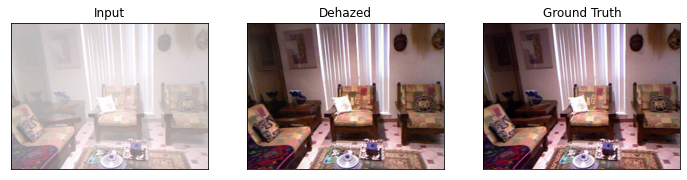

psnr: 28.559865473696178   ssim: 0.9534563422203064


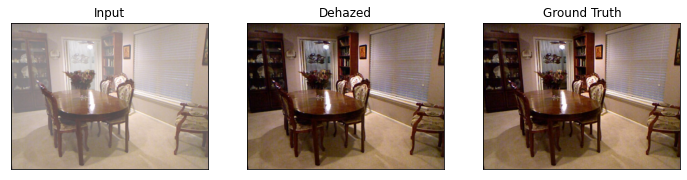

psnr: 30.97606571443   ssim: 0.9721910953521729


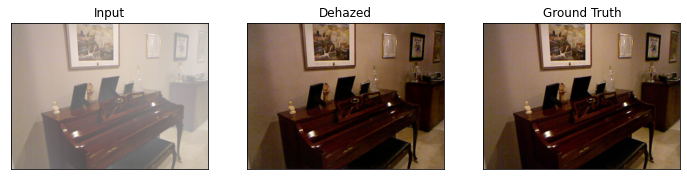

psnr: 27.157409883108137   ssim: 0.9384185671806335


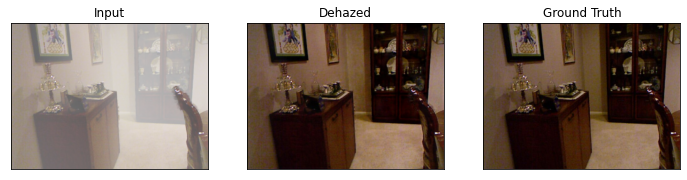

psnr: 30.922498455731954   ssim: 0.9335654973983765


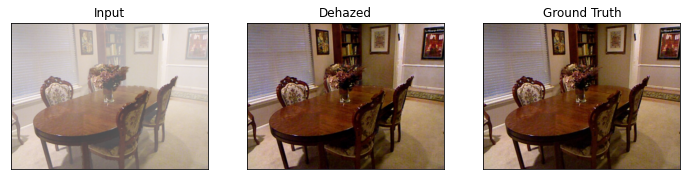

psnr: 30.261844321607   ssim: 0.9576792120933533


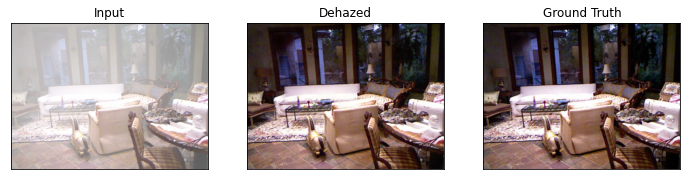

psnr: 30.22796891548754   ssim: 0.9384146928787231


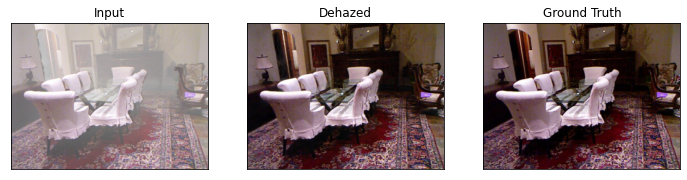

psnr: 29.134268712224234   ssim: 0.9161418080329895


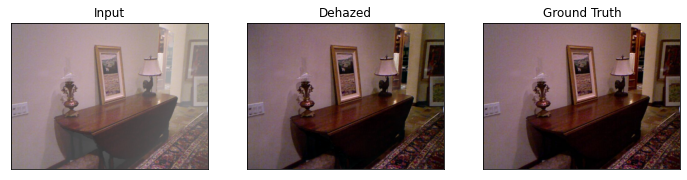

psnr: 30.54835887835827   ssim: 0.9607212543487549


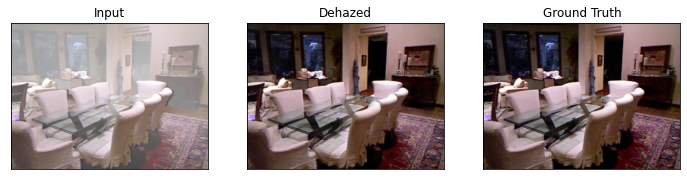

psnr: 30.338322569048813   ssim: 0.9496618509292603


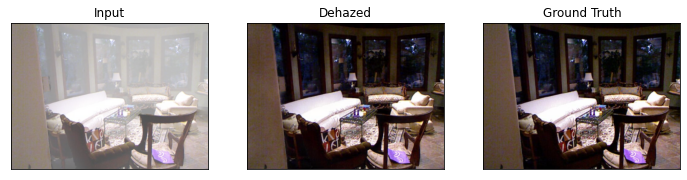

psnr: 29.531013726764883   ssim: 0.9295654296875


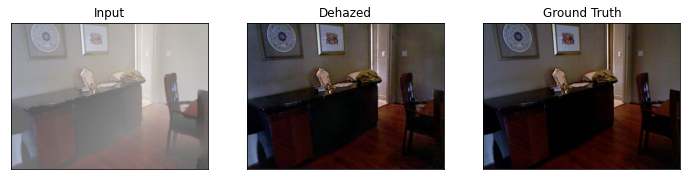

psnr: 28.79685827646008   ssim: 0.8932597637176514


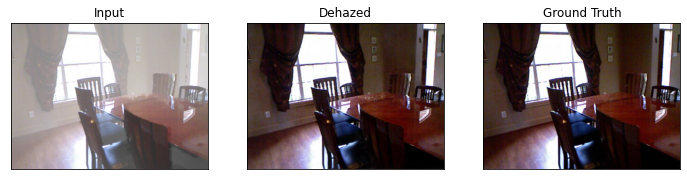

psnr: 29.787964680716282   ssim: 0.9298462271690369


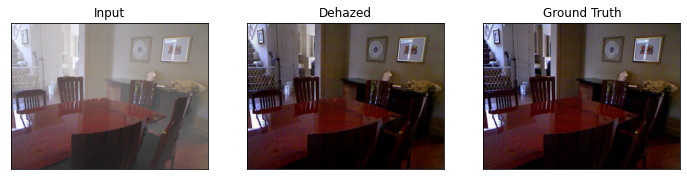

psnr: 27.388375472237293   ssim: 0.9229894280433655


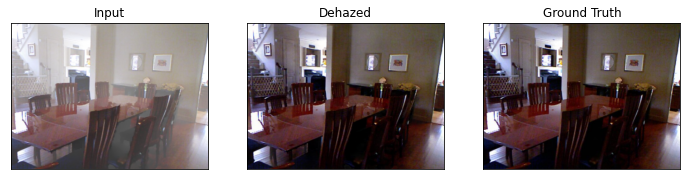

psnr: 27.053148755129172   ssim: 0.9339311122894287


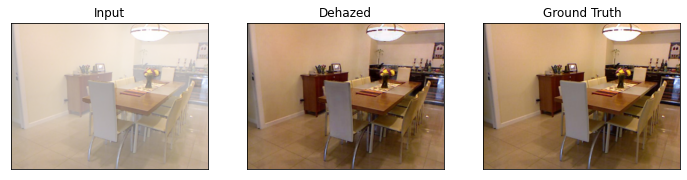

psnr: 27.590423563567384   ssim: 0.9586619734764099


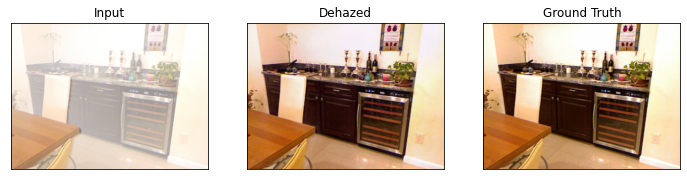

psnr: 28.69760831297409   ssim: 0.9631876945495605


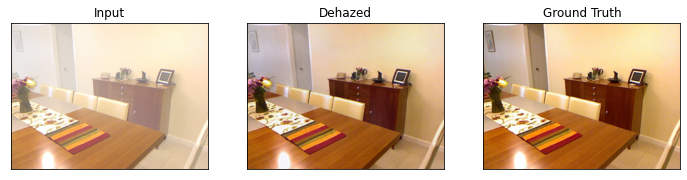

psnr: 24.65899700950309   ssim: 0.9584318995475769


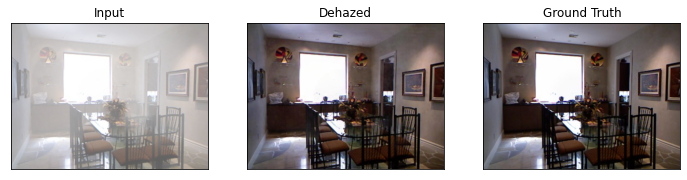

psnr: 28.578147228725523   ssim: 0.9502991437911987


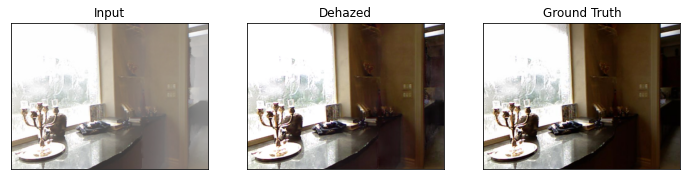

psnr: 25.216375034793977   ssim: 0.85381019115448


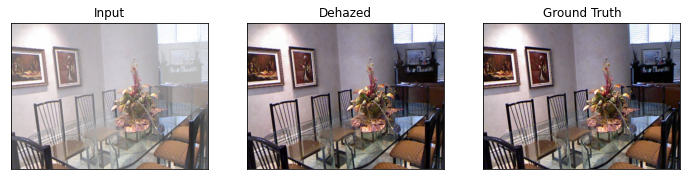

psnr: 29.940475004588862   ssim: 0.9636549353599548


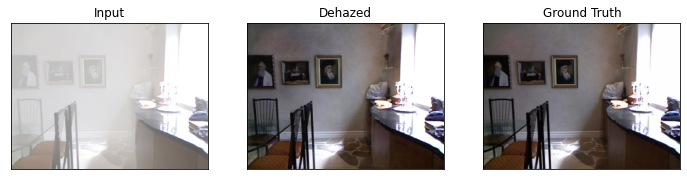

psnr: 28.184135640603486   ssim: 0.9621912837028503


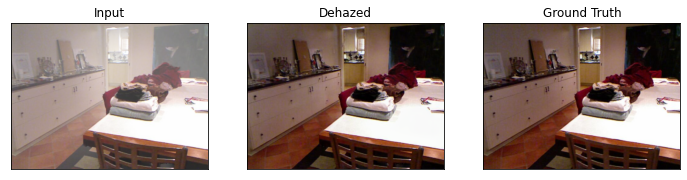

psnr: 31.8617324200604   ssim: 0.9652005434036255


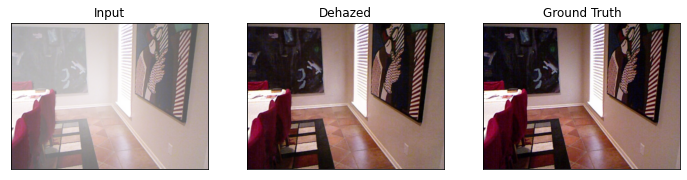

psnr: 27.34581412299655   ssim: 0.9373012185096741


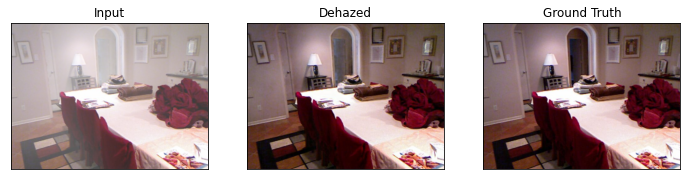

psnr: 27.552722037285484   ssim: 0.9600410461425781


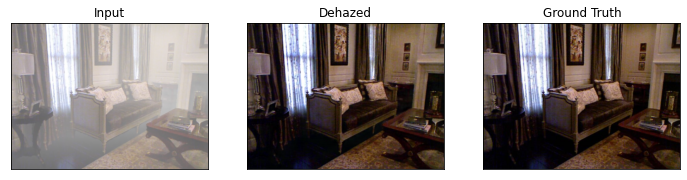

psnr: 32.022861299678105   ssim: 0.9354884028434753


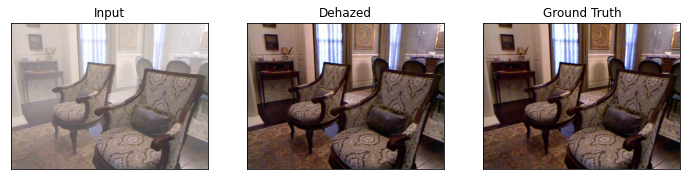

psnr: 28.22713423424758   ssim: 0.9617423415184021


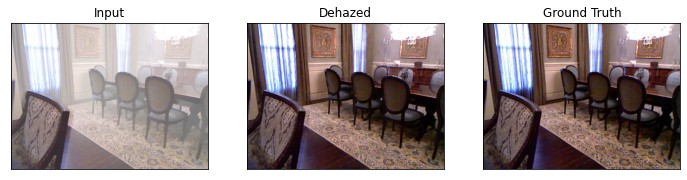

psnr: 27.653875220018797   ssim: 0.9589701890945435


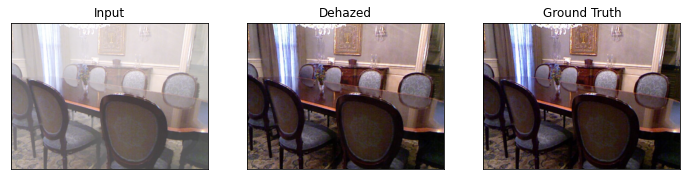

psnr: 26.769473398653844   ssim: 0.9408555626869202


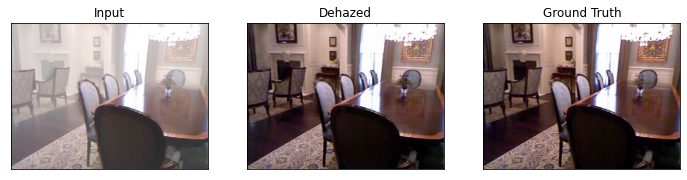

psnr: 29.26206613327571   ssim: 0.9546090960502625


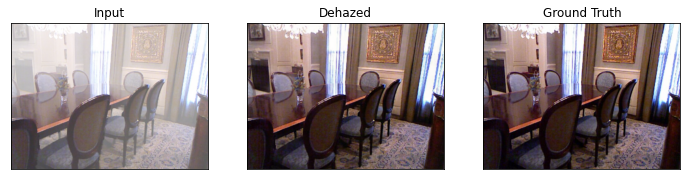

psnr: 27.178552799763345   ssim: 0.9524821043014526


In [7]:
## GCA-Net
def edge_compute(x):
    x_diffx = torch.abs(x[:,:,1:] - x[:,:,:-1])
    x_diffy = torch.abs(x[:,1:,:] - x[:,:-1,:])

    y = x.new(x.size())
    y.fill_(0)
    y[:,:,1:] += x_diffx
    y[:,:,:-1] += x_diffx
    y[:,1:,:] += x_diffy
    y[:,:-1,:] += x_diffy
    y = torch.sum(y,0,keepdim=True)/3
    y /= 4
    return y

GCA_psnr = []
GCA_ssim = []
from GCANet.GCANet import GCANet
net = GCANet(in_c=4, out_c=3, only_residual=True).cuda()
net.load_state_dict(torch.load('GCANet/models/wacv_gcanet_dehaze.pth', map_location='cuda:0'))
net.eval()
for img, truth in dataset_loader(dataset_name):
    img = np.array(img).astype('float')
    img_data = torch.from_numpy(img.transpose((2, 0, 1))).float()
    in_img = Image.fromarray(img_data.numpy().astype(np.uint8).transpose(1, 2, 0))
    edge_data = edge_compute(img_data)
    in_data = torch.cat((img_data, edge_data), dim=0).unsqueeze(0) - 128 
    in_data = in_data.cuda()
    with torch.no_grad():
        pred = net(Variable(in_data))
    out_img_data = (pred.data[0].cpu().float() + img_data).round().clamp(0, 255)
    out_img = Image.fromarray(out_img_data.numpy().astype(np.uint8).transpose(1, 2, 0))
    psnr_value = psnr(out_img, truth)
    ssim_value = ssim(out_img, truth)
    GCA_psnr.append(psnr_value)
    GCA_ssim.append(ssim_value)
    fig = plt.figure(figsize=(12,5))
    ax1 = fig.add_subplot(131)
    ax2 = fig.add_subplot(132)
    ax3 = fig.add_subplot(133)
    ax1.imshow(in_img)
    ax2.imshow(out_img)
    ax3.imshow(truth)
    for ax in [ax1, ax2, ax3]:
        ax.set_xticks([])
        ax.set_yticks([])
    ax1.title.set_text('Input')
    ax2.title.set_text('Dehazed')
    ax3.title.set_text('Ground Truth')
    plt.show()
    print(f'psnr: {psnr_value}   ssim: {ssim_value}')

dataset/SOTS/indoor/hazy
dataset/SOTS/indoor/clear


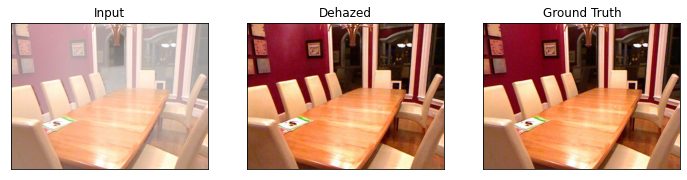

psnr: 30.377569048276442   ssim: 0.9692025780677795


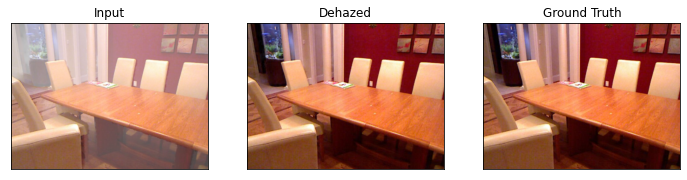

psnr: 35.82785416012725   ssim: 0.9831977486610413


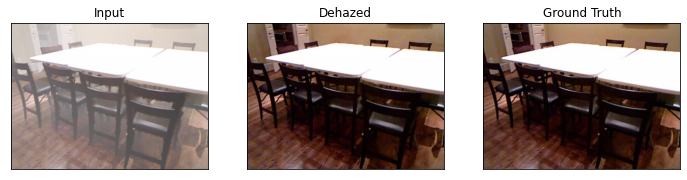

psnr: 37.22850595382849   ssim: 0.9851014018058777


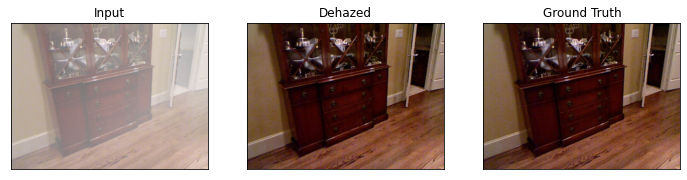

psnr: 35.19917065009995   ssim: 0.985418438911438


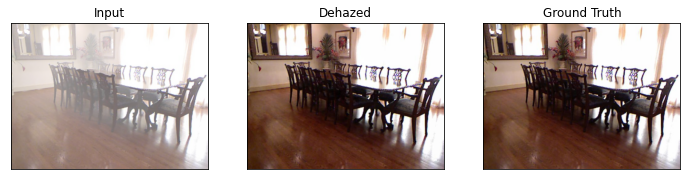

psnr: 33.93167113104444   ssim: 0.984028697013855


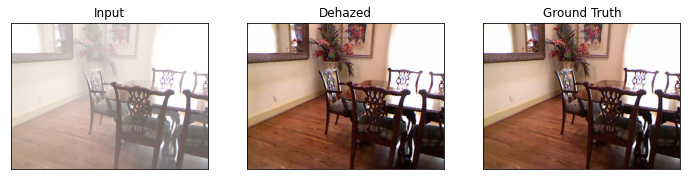

psnr: 32.788675550529355   ssim: 0.9852386713027954


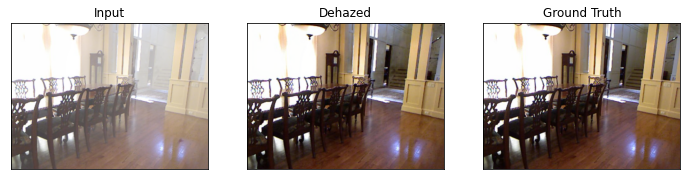

psnr: 34.76906304973129   ssim: 0.9835591912269592


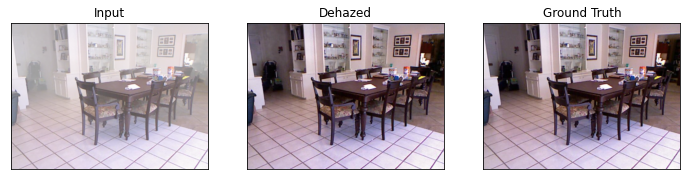

psnr: 35.09356628949673   ssim: 0.9864031076431274


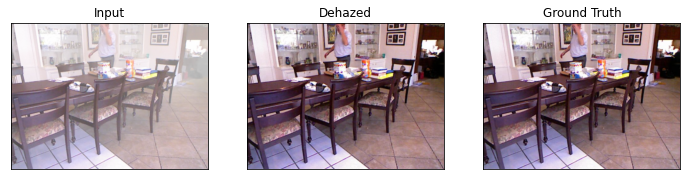

psnr: 33.7402458596643   ssim: 0.9881160855293274


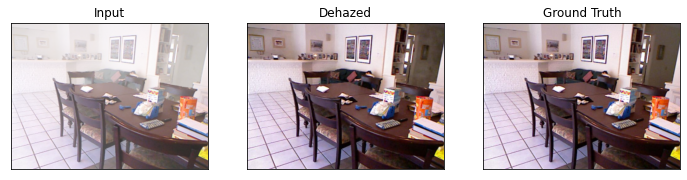

psnr: 33.18984469109389   ssim: 0.983914852142334


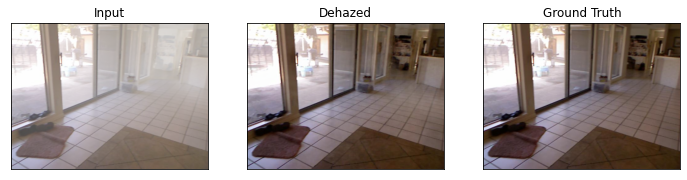

psnr: 31.332280159528587   ssim: 0.9808713793754578


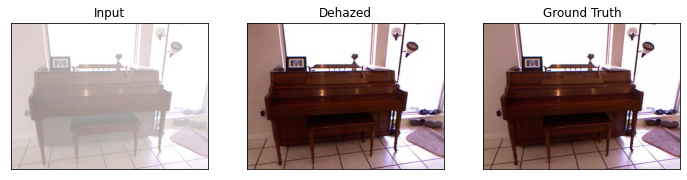

psnr: 33.13782868064477   ssim: 0.9848496913909912


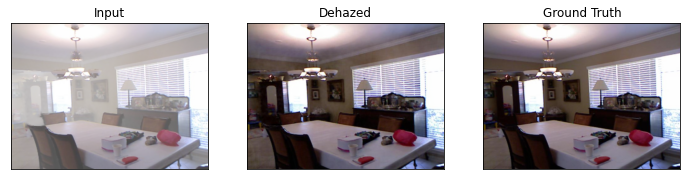

psnr: 32.90460045905307   ssim: 0.9785507321357727


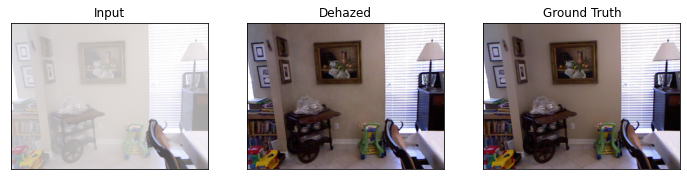

psnr: 32.5236105135214   ssim: 0.9775062799453735


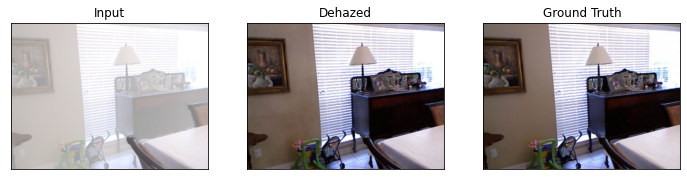

psnr: 34.554433801900636   ssim: 0.9835877418518066


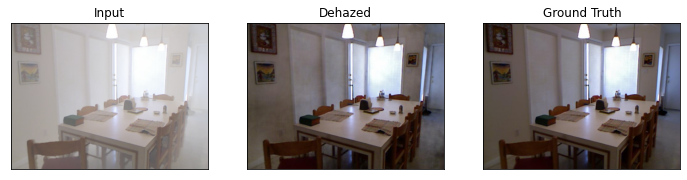

psnr: 32.0836175717252   ssim: 0.9772779941558838


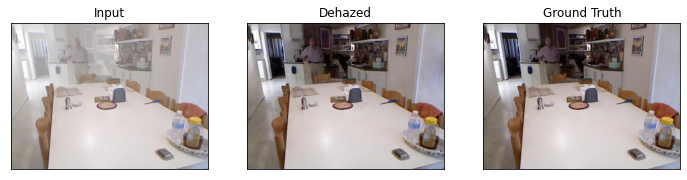

psnr: 33.74843505953526   ssim: 0.9849035143852234


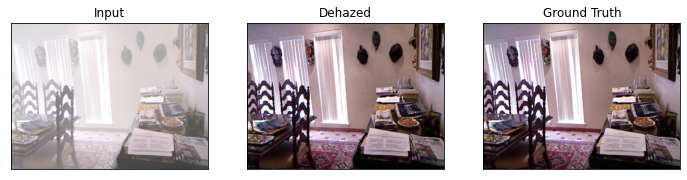

psnr: 34.143881862108366   ssim: 0.9869102239608765


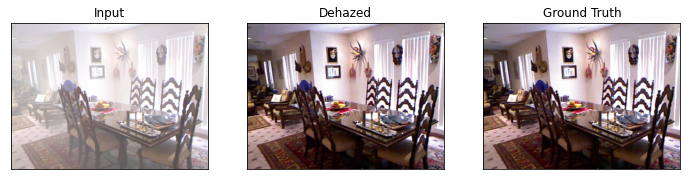

psnr: 33.27941046335749   ssim: 0.9877102375030518


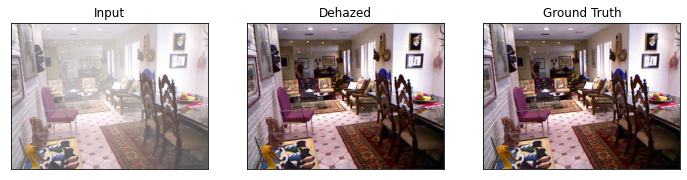

psnr: 34.95037500833877   ssim: 0.9900388121604919


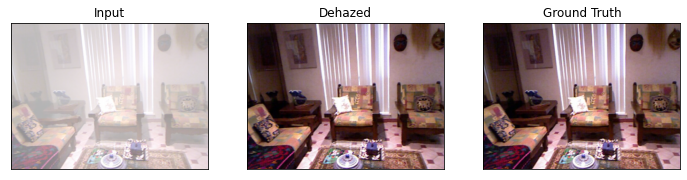

psnr: 34.71714430025188   ssim: 0.9847087860107422


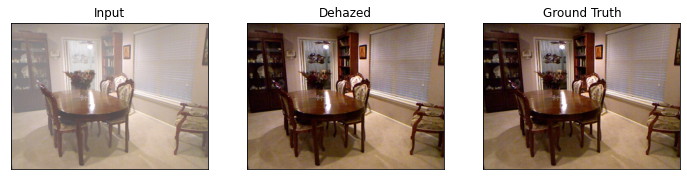

psnr: 35.746997875659005   ssim: 0.9882339835166931


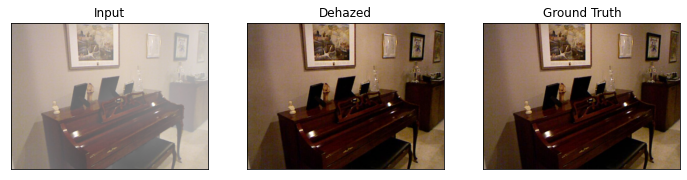

psnr: 38.09594752091705   ssim: 0.9860668182373047


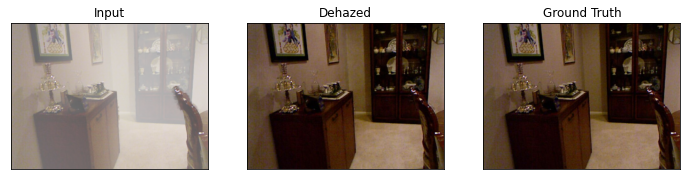

psnr: 33.400483277697305   ssim: 0.9794787168502808


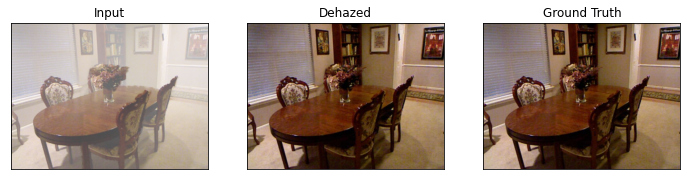

psnr: 33.63285621704481   ssim: 0.9854191541671753


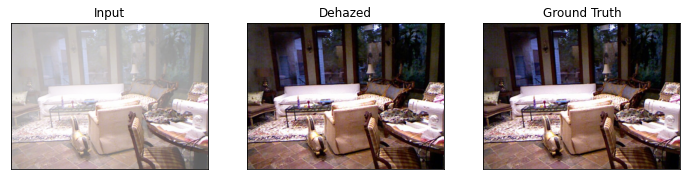

psnr: 33.76216002529898   ssim: 0.9797163605690002


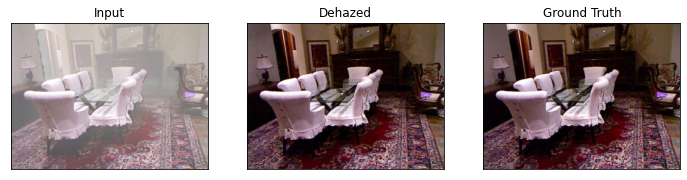

psnr: 37.31647032138859   ssim: 0.983980119228363


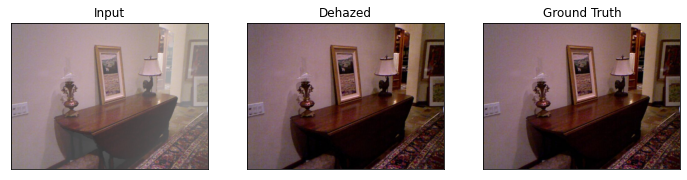

psnr: 37.95759693484062   ssim: 0.9888375401496887


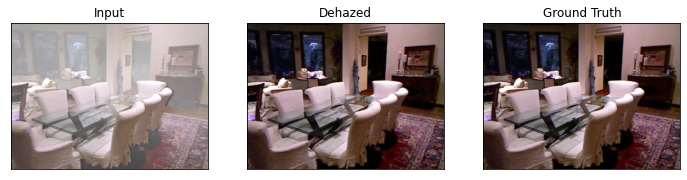

psnr: 36.45286635793076   ssim: 0.9824606776237488


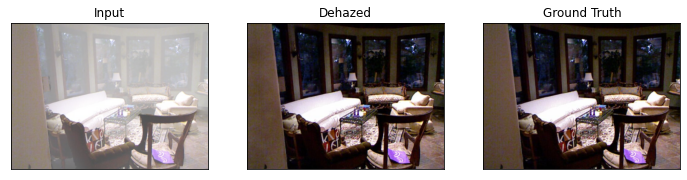

psnr: 35.80370495254356   ssim: 0.9778707027435303


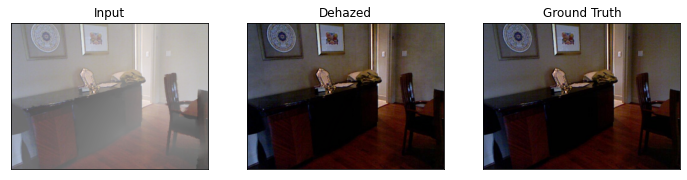

psnr: 31.959281247038863   ssim: 0.9748612642288208


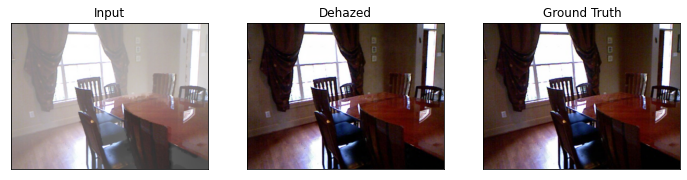

psnr: 35.73228559141489   ssim: 0.976820707321167


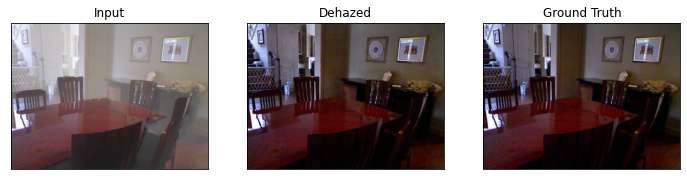

psnr: 34.3898183116478   ssim: 0.9802169799804688


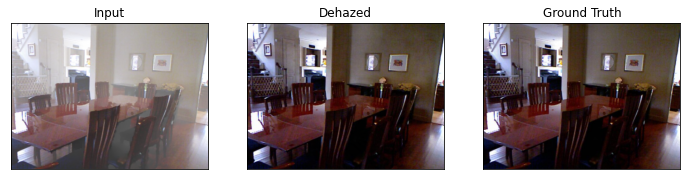

psnr: 35.56021095230127   ssim: 0.9795446991920471


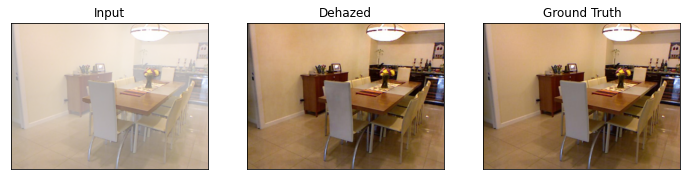

psnr: 33.94781743124985   ssim: 0.9818606972694397


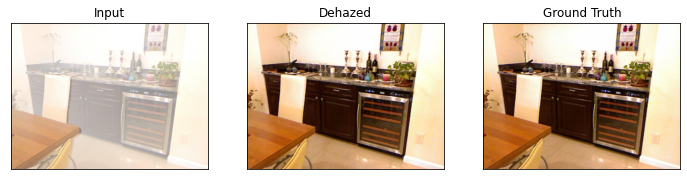

psnr: 34.40284603088448   ssim: 0.987387478351593


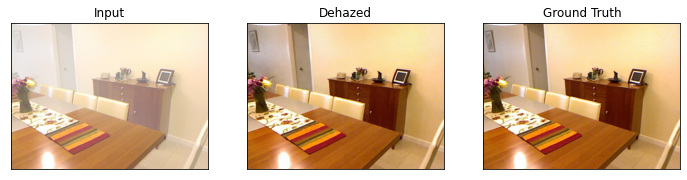

psnr: 35.7808137021031   ssim: 0.9881811141967773


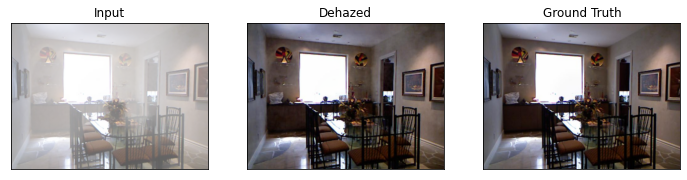

psnr: 30.161179915859414   ssim: 0.9729337692260742


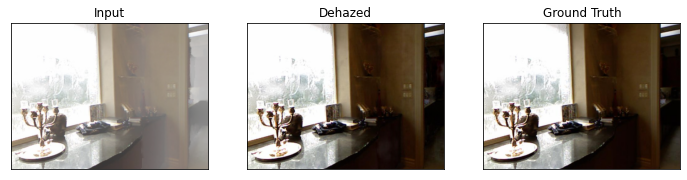

psnr: 35.29342691471193   ssim: 0.9674127697944641


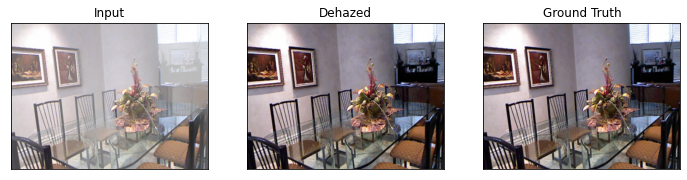

psnr: 35.30176344747464   ssim: 0.9870275259017944


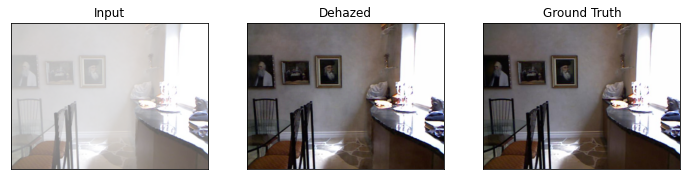

psnr: 30.78017168844336   ssim: 0.9701449275016785


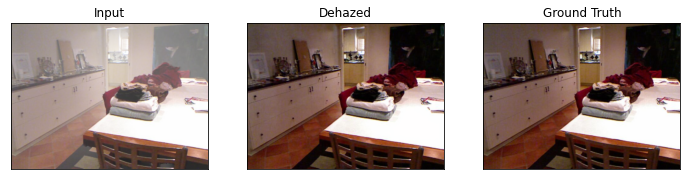

psnr: 35.94558788529868   ssim: 0.9866980314254761


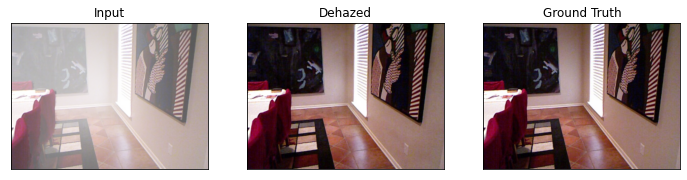

psnr: 33.49191523329781   ssim: 0.9807151556015015


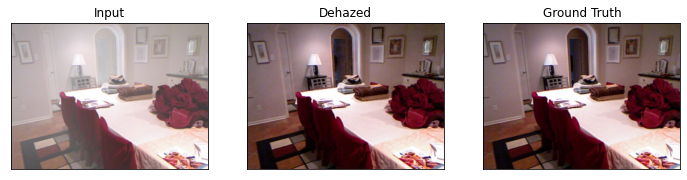

psnr: 33.89419131759939   ssim: 0.9861902594566345


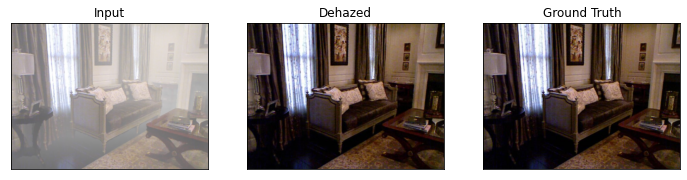

psnr: 35.612790311633596   ssim: 0.9817061424255371


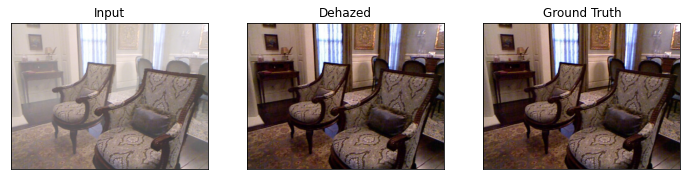

psnr: 35.44036372322696   ssim: 0.9875043630599976


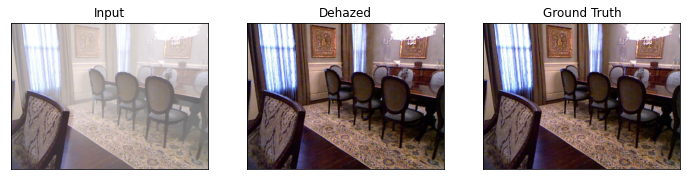

psnr: 36.165848439986696   ssim: 0.9870165586471558


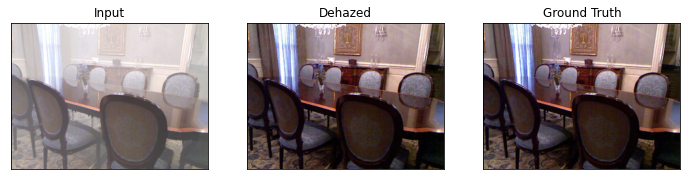

psnr: 33.86382794801045   ssim: 0.981632649898529


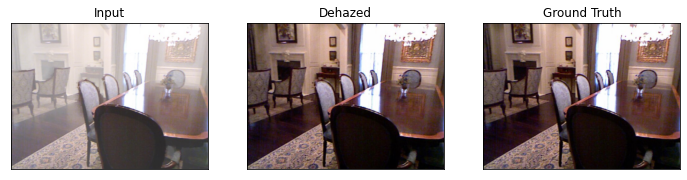

psnr: 35.31192292649534   ssim: 0.9824220538139343


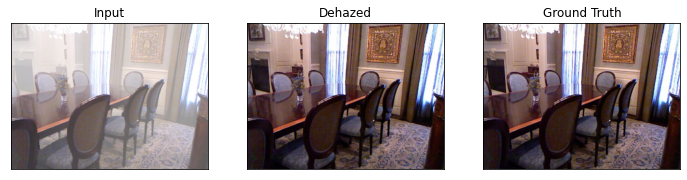

psnr: 34.934075091183544   ssim: 0.9849472641944885


In [11]:
## FFA-Net
import torchvision.transforms as tfs 
from FFANet.net.models import FFA
ckp=torch.load('FFANet/net/trained_models/'+
               'its_train_ffa_3_19.pk' if 'indoor' in dataset_name or 'I' in dataset_name else 'ots_train_ffa_3_19.pk'
               ,map_location='cuda')
net=FFA(gps=3,blocks=19)
net=torch.nn.DataParallel(net)
net.load_state_dict(ckp['model'])
net.eval()
FFA_psnr = []
FFA_ssim = []
for img, truth in dataset_loader(dataset_name):
    haze1= tfs.Compose([
        tfs.ToTensor(),
        tfs.Normalize(mean=[0.64, 0.6, 0.58],std=[0.14,0.15, 0.152])
    ])(img)[None,::]
    haze_no=tfs.ToTensor()(img)[None,::]
    with torch.no_grad():
        pred = net(haze1)
    ts=(torch.squeeze(pred.clamp(0,1).cpu())*255.0).round()
    out_img = Image.fromarray(ts.numpy().astype(np.uint8).transpose(1, 2, 0))
    psnr_value = psnr(out_img, truth)
    ssim_value = ssim(out_img, truth)
    FFA_psnr.append(psnr_value)
    FFA_ssim.append(ssim_value)
    fig = plt.figure(figsize=(12,5))
    ax1 = fig.add_subplot(131)
    ax2 = fig.add_subplot(132)
    ax3 = fig.add_subplot(133)
    ax1.imshow(img)
    ax2.imshow(out_img)
    ax3.imshow(truth)
    for ax in [ax1, ax2, ax3]:
        ax.set_xticks([])
        ax.set_yticks([])
    ax1.title.set_text('Input')
    ax2.title.set_text('Dehazed')
    ax3.title.set_text('Ground Truth')
    plt.show()
    print(f'psnr: {psnr_value}   ssim: {ssim_value}')